# EDA Code for Spatial Exploration

Import all libraries used.

In [1]:
import io
import os

import imageio
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.express as px
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.mixture import GaussianMixture

## Run this if plotly plots don't show

In [2]:
import plotly.io as pio
pio.renderers.default='notebook'

Set plot style for <code>matplotlib</code>.

In [3]:
plt.style.use('fivethirtyeight')

Load all processed weather stations.

In [4]:
# List of dataframes corresponding to each weather station
weather_stations = [
    pd.read_csv('../weather/processed/' + file, parse_dates=['UTC_DATE'], usecols=range(1, 15)) for file in os.listdir('../weather/processed')
]

# List of weather station names, in alphabetical order
station_names = [file[:-4] for file in os.listdir('../weather/processed')]

# Let's view the first weather station for BARRIE-ORO
weather_stations[0].head()

,UTC_DATE,STATION_NAME,x,y,PRECIP_AMOUNT,TEMP,DEW_POINT_TEMP,RELATIVE_HUMIDITY,STATION_PRESSURE,WIND_DIRECTION,WIND_SPEED,WIND_X,WIND_Y,VAPOR_PRESSURE
0,2014-11-05 20:00:00,BARRIE-ORO,-79.55,44.48,0.0,6.2,-0.8,61.0,98.29,26.0,18.0,-17.726540,-3.125667,0.000959
1,2014-11-05 21:00:00,BARRIE-ORO,-79.55,44.48,0.0,5.9,-0.3,64.0,98.30,26.0,13.0,-12.802501,-2.257426,0.000987
2,2014-11-05 22:00:00,BARRIE-ORO,-79.55,44.48,0.0,5.5,0.0,68.0,98.34,26.0,9.0,-8.863270,-1.562834,0.001024
3,2014-11-05 23:00:00,BARRIE-ORO,-79.55,44.48,0.0,5.4,0.4,70.0,98.39,25.0,6.0,-5.638156,-2.052121,0.001047
4,2014-11-06 00:00:00,BARRIE-ORO,-79.55,44.48,0.0,5.0,0.9,75.0,98.42,24.0,5.0,-4.330127,-2.500000,0.001095


Let's begin our spatial exploration. First, let's look at each feature across the 10 weather stations, and let's look at the standard deviation at each time step. A larger standard deviation indicates greater spatial variability and less spatial correlation between features (that is, more new information is being provided).

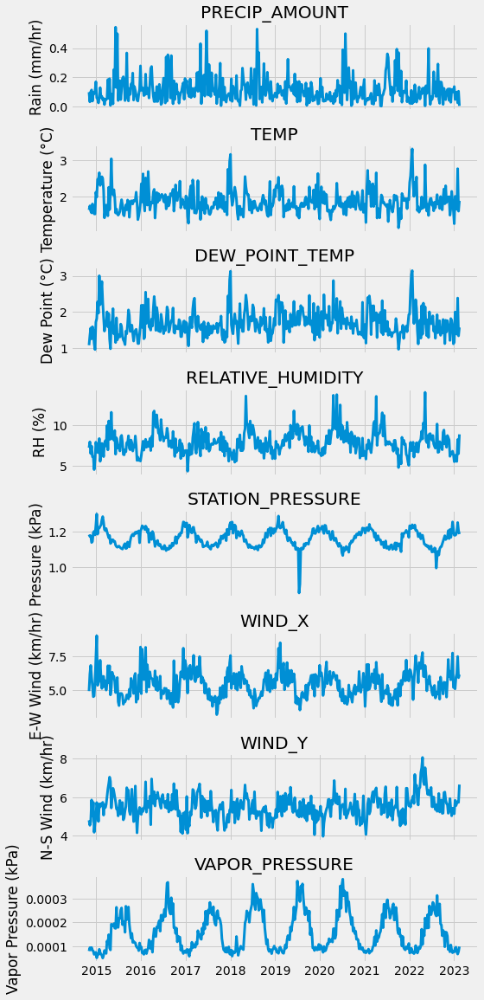

In [5]:
features = ['PRECIP_AMOUNT', 'TEMP', 'DEW_POINT_TEMP', 'RELATIVE_HUMIDITY', 'STATION_PRESSURE', 'WIND_X', 'WIND_Y',
           'VAPOR_PRESSURE']

def plot_feature(ax, feature):
    """
    Create plot for a feature.
    """
    time_column = weather_stations[0]['UTC_DATE']
    feature_columns = np.array([df[feature].to_numpy() for df in weather_stations])
    
    std = np.std(feature_columns, axis=0)

    temp_df = pd.DataFrame({'Date': time_column, 'Range': std})

    # Group by 2 weeks and get the mean standard deviation across those two weeks.
    # This is to make the plot less messy.
    result = temp_df.groupby(temp_df['Date'].dt.to_period('2W'))['Range'].mean()


    ax.plot(result.index.to_timestamp(), result, lw=3)
    ax.set_title(feature)

fig, axs = plt.subplots(8, 1, figsize=(8, 16), sharex=True)

for ax, feature in zip(axs, features):
    plot_feature(ax, feature)

# Label y axis
axs[0].set_ylabel('Rain (mm/hr)')
axs[1].set_ylabel('Temperature (°C)')
axs[2].set_ylabel('Dew Point (°C)')
axs[3].set_ylabel('RH (%)')
axs[4].set_ylabel('Pressure (kPa)')
axs[5].set_ylabel('E-W Wind (km/hr)')
axs[6].set_ylabel('N-S Wind (km/hr)')
axs[7].set_ylabel('Vapor Pressure (kPa)')

plt.tight_layout()

It seems like standard deviation isn't really high, considering the variability of weather features. Let's continue our exploration by plotting correlation matrices for each feature, where a value closer to 1 indicates greater linear correlation.

In [6]:
# Let's see if there are two weather stations with a very, very high correlation between them.
def plot_correlation(feature):
    plt.figure(figsize=(8, 8), dpi=72)
    
    time_column = weather_stations[0]['UTC_DATE']
    feature_columns = np.array([df[feature].to_numpy() for df in weather_stations])
    correlation_matrix = np.corrcoef(feature_columns, rowvar=True)  # Calculate corr matrix
    
    # Annotate the heatmap with correlation values (rounded to 2 decimal places)
    for i in range(correlation_matrix.shape[0]):
        for j in range(correlation_matrix.shape[1]):
            plt.text(j, i, f'{correlation_matrix[i, j]:.2f}', ha='center', va='center', color='white')

    # Plotting the correlation matrix as a heatmap
    plt.imshow(correlation_matrix, cmap='viridis', interpolation='nearest')
    plt.colorbar(label='Correlation coefficient')
    plt.title('Correlation of ' + feature)
    plt.grid()  # Turn grid off
    plt.xticks(range(len(station_names)), station_names, rotation='vertical')
    plt.yticks(range(len(station_names)), station_names)

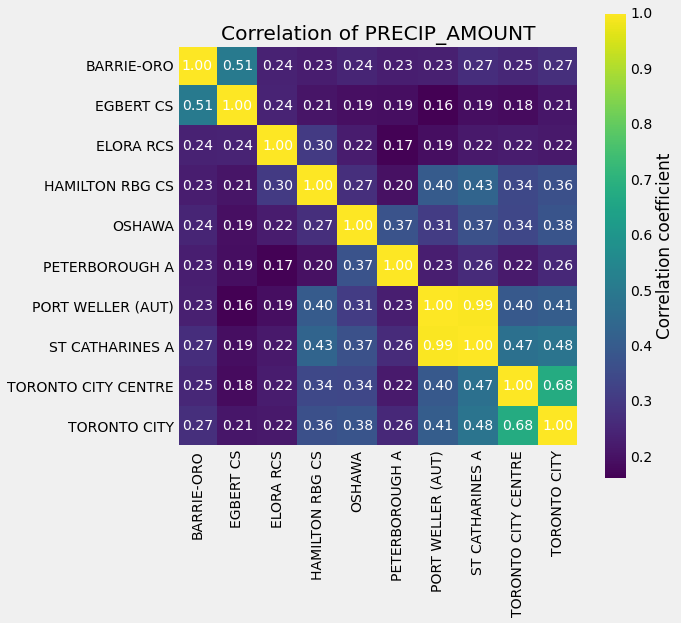

In [7]:
plot_correlation('PRECIP_AMOUNT')
# plt.savefig('../../../images/corr_precip_amount.png', bbox_inches='tight')

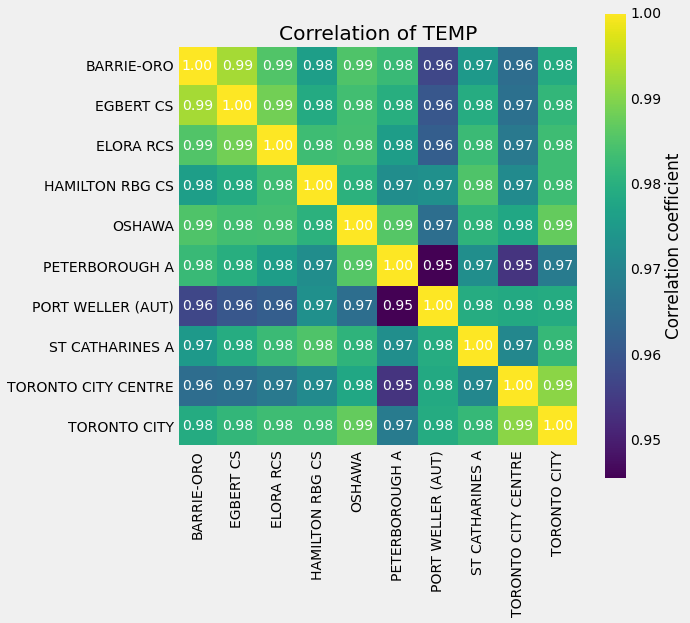

In [8]:
plot_correlation('TEMP')
#plt.savefig('../../../images/corr_temp.png', bbox_inches='tight')

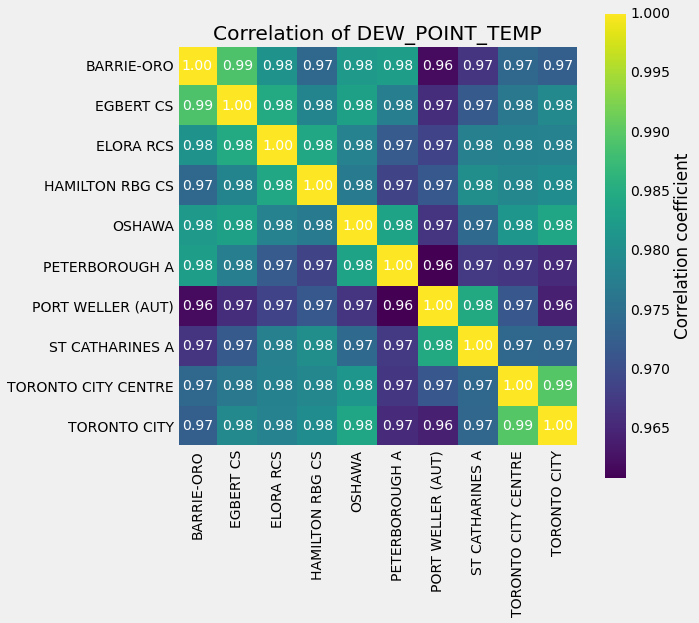

In [9]:
plot_correlation('DEW_POINT_TEMP')
#plt.savefig('../../../images/corr_dew_point_temp.png', bbox_inches='tight')

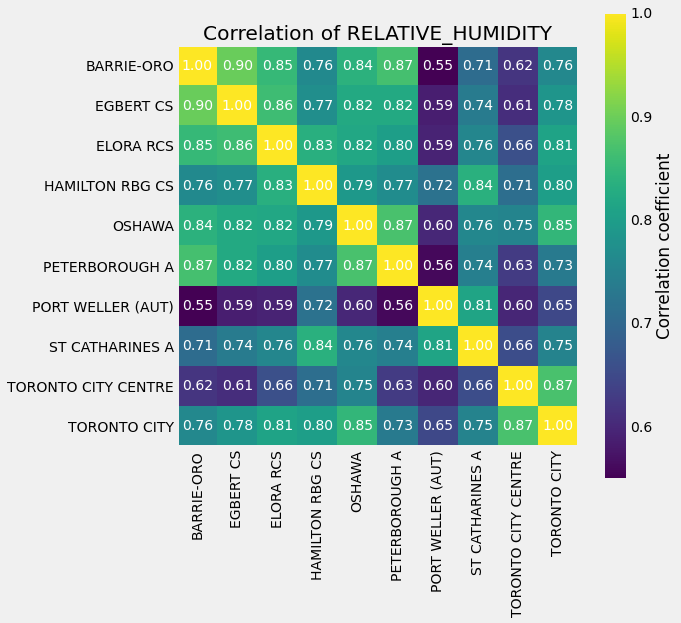

In [10]:
plot_correlation('RELATIVE_HUMIDITY')
#plt.savefig('../../../images/corr_relative_humidity.png', bbox_inches='tight')

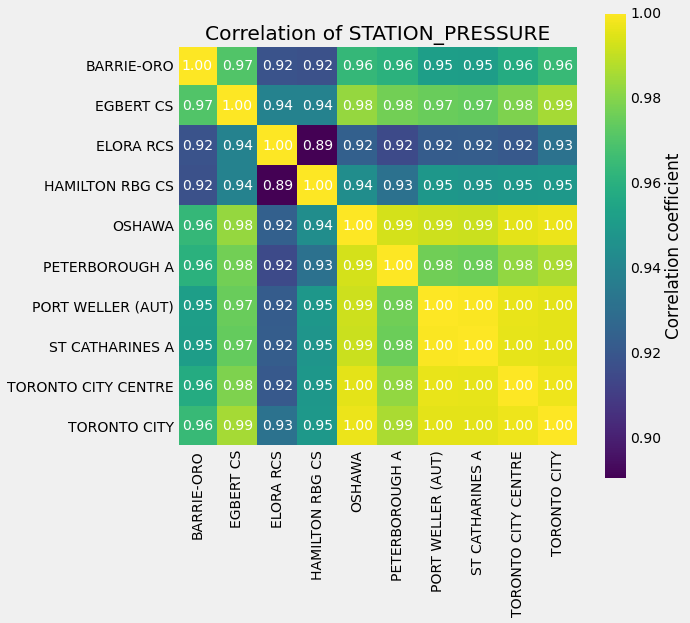

In [11]:
plot_correlation('STATION_PRESSURE')
#plt.savefig('../../../images/corr_station_pressure.png', bbox_inches='tight')

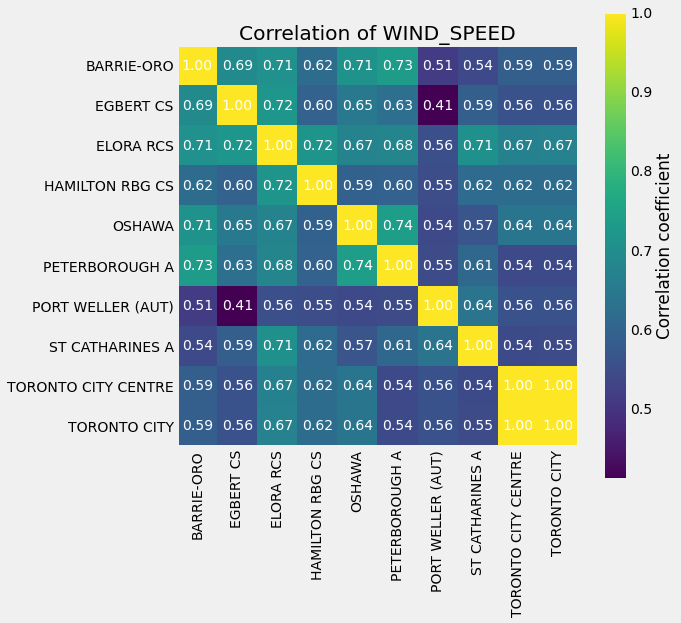

In [12]:
plot_correlation('WIND_SPEED')
#plt.savefig('../../../images/corr_wind_speed.png', bbox_inches='tight')

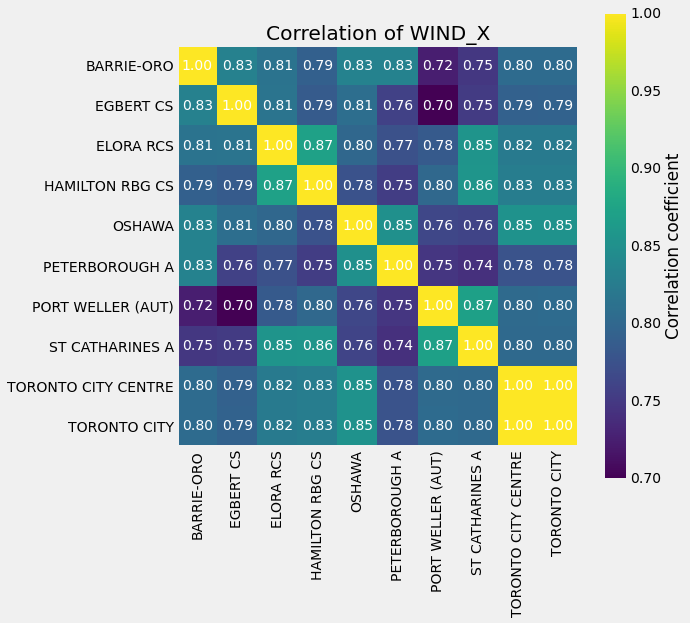

In [13]:
plot_correlation('WIND_X')
#plt.savefig('../../../images/corr_wind_x.png', bbox_inches='tight')

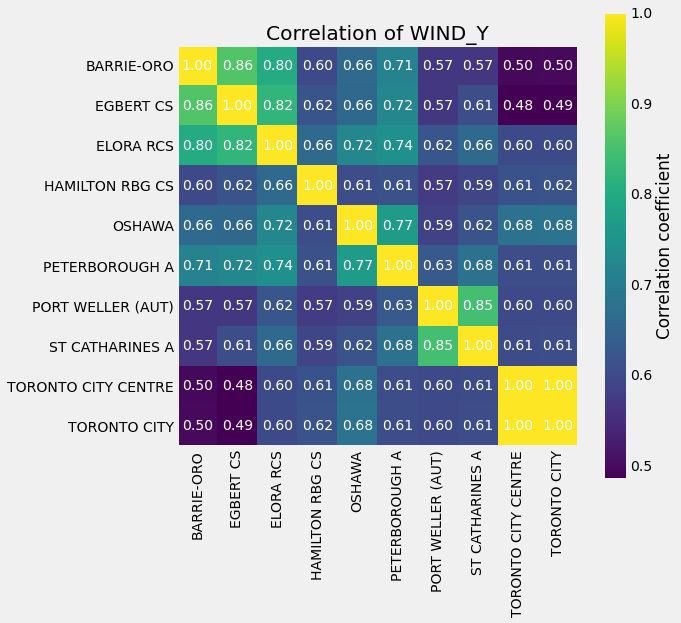

In [14]:
plot_correlation('WIND_Y')
#plt.savefig('../../../images/corr_wind_y.png', bbox_inches='tight')

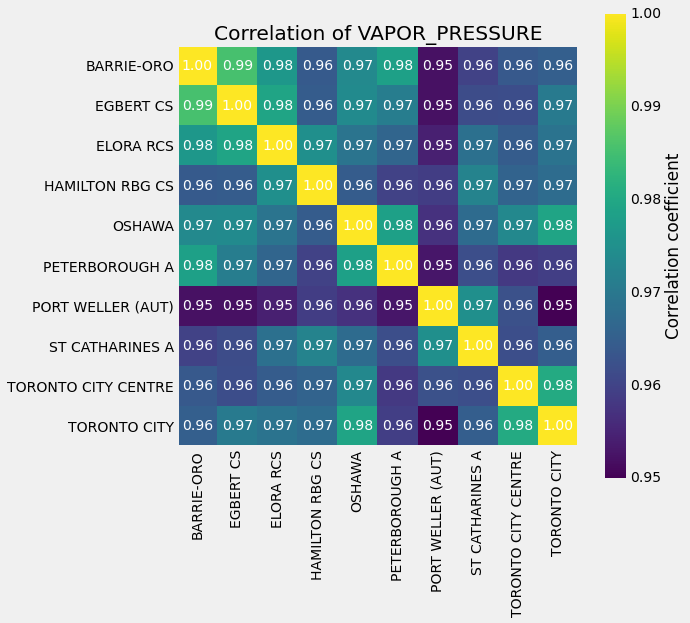

In [15]:
plot_correlation('VAPOR_PRESSURE')
#plt.savefig('../../../images/corr_vapor_pressure.png', bbox_inches='tight')

Note that some weather stations have a correlation of near 1; we can claim these are colinear. Let's write a function to figure out which stations need removal for which feature. A threshold of >=0.99 seems reasonable for this.

In [16]:
def suggest_removal(feature):
    """
    Function that suggests weather stations to remove given a feature.
    """
    
    feature_columns = np.array([df[feature].to_numpy() for df in weather_stations])
    
    # Get the correlation matrix
    correlation_matrix = np.corrcoef(feature_columns, rowvar=True)
    
    threshold = 0.99
    
    num_features = correlation_matrix.shape[0]
    upper_tri = np.triu(np.ones((num_features, num_features)), k=1).astype(bool)
    
    high_corr_idx = np.where(np.abs(correlation_matrix) >= threshold)
    high_corr_idx = [(i, j) for i, j in zip(*high_corr_idx) if upper_tri[i, j]]
    
    features_to_remove = set()
    for idx1, idx2 in high_corr_idx:
        feature1 = station_names[idx1]
        feature2 = station_names[idx2]
        features_to_remove.add(feature1 if np.sum(np.abs(correlation_matrix[idx1])) > np.sum(np.abs(correlation_matrix[idx2])) else feature2)
    
    return features_to_remove

# Features to check for high correlation
features = ['PRECIP_AMOUNT', 'TEMP', 'DEW_POINT_TEMP', 'RELATIVE_HUMIDITY', 'STATION_PRESSURE',
       'WIND_SPEED', 'WIND_X', 'WIND_Y', 'VAPOR_PRESSURE']

for feature in features:
    print(f'{feature}: {suggest_removal(feature)}')

PRECIP_AMOUNT: {'ST CATHARINES A'}
TEMP: {'TORONTO CITY', 'EGBERT CS'}
DEW_POINT_TEMP: set()
RELATIVE_HUMIDITY: set()
STATION_PRESSURE: {'PORT WELLER (AUT)', 'TORONTO CITY', 'TORONTO CITY CENTRE', 'OSHAWA'}
WIND_SPEED: {'TORONTO CITY'}
WIND_X: {'TORONTO CITY'}
WIND_Y: {'TORONTO CITY'}
VAPOR_PRESSURE: set()


These features in these stations will not be considered in the model training -- they are redundant and serve little purpose.

Next, let us see if there any natural clusters for features, namely, the precipitation amount. But before that, as cluster algorithms suffers from the curse of dimensionality due to the Euclidiean distance metric losing meaning, PCA will be used to reduce dimensionality.

In [17]:
def plot_pc(feature, n_components=3):
    """
    Plot the PCA transform result in PCA space. Plotting will include
    a maximum of 4 dimensions, although more dimensions can be used
    for PCA, as specified in n_components.
    """
    
    X = np.array([df[feature].to_numpy() for df in weather_stations]).T
    pca = PCA(n_components=n_components, random_state=42)
    transformed = pca.fit_transform(X)

    # Get the explained variance ratio
    explained_var_ratio = pca.explained_variance_ratio_

    # Print the explained variance ratio for each principal component
    for i, evr in enumerate(explained_var_ratio):
        print(f"Explained variance ratio of PC{i + 1}: {evr:.4f}")
    
    if n_components == 3:
        fig = px.scatter_3d(x=transformed[:, 0],
                        y=transformed[:, 1],
                        z=transformed[:, 2],
                        color=transformed[:, 0])
    else:
        fig = px.scatter_3d(x=transformed[:, 0],
                y=transformed[:, 1],
                z=transformed[:, 2],
                color=transformed[:, 3])
    fig.update_layout(title=f'{feature} PCA')
    fig.show('notebook')

In [35]:
plot_pc('PRECIP_AMOUNT', 5)

Explained variance ratio of PC1: 0.3816
Explained variance ratio of PC2: 0.1367
Explained variance ratio of PC3: 0.0946
Explained variance ratio of PC4: 0.0902
Explained variance ratio of PC5: 0.0866


In [34]:
#plot_pc('TEMP', 3)

In [33]:
#plot_pc('DEW_POINT_TEMP', 3)

In [32]:
#plot_pc('RELATIVE_HUMIDITY', 4)

In [36]:
plot_pc('STATION_PRESSURE', 3)

Explained variance ratio of PC1: 0.9655
Explained variance ratio of PC2: 0.0126
Explained variance ratio of PC3: 0.0096


In [31]:
 #plot_pc('WIND_X', 3)

From these 3D visualizations. Only PRECIP_AMOUNT and STATION_PRESSURE appear to have distict clusters. Let's attempt to cluster both. Cluster labels could possibly be used as a feature. First, let's plot inertia for PRECIP_AMOUNT to determine the optimal number of clusters. It seems that 4 clusters is reasonable.

In [24]:
precip = np.array([df['PRECIP_AMOUNT'].to_numpy() for df in weather_stations]).T
pca_precip = PCA(n_components=4, random_state=42)
transformed_precip = pca_precip.fit_transform(precip)

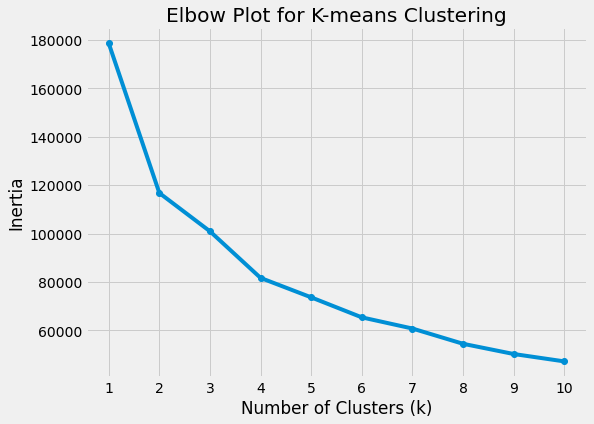

In [25]:
inertia = []
for k in range(1, 11):
    kmeans = KMeans(n_clusters=k, n_init='auto')
    kmeans.fit(transformed_precip)
    inertia.append(kmeans.inertia_)

# Plotting the elbow plot
plt.figure(figsize=(8, 6))
plt.plot(range(1, 11), inertia, marker='o', linestyle='-')

# Plot labels
plt.xlabel('Number of Clusters (k)')
plt.ylabel('Inertia')
plt.title('Elbow Plot for K-means Clustering')
plt.xticks(range(1, 11))
plt.grid(True)
plt.show()

In [26]:
pressure = np.array([df['STATION_PRESSURE'].to_numpy() for df in weather_stations]).T
pca_pressure = PCA(n_components=3)
transformed_pressure = pca_pressure.fit_transform(pressure)

kmeans_precip = KMeans(n_clusters=4, n_init='auto')
kmeans_precip.fit(transformed_precip)

kmeans_pressure = KMeans(n_clusters=3, n_init='auto')
kmeans_pressure.fit(transformed_pressure)

KMeans(n_clusters=3, n_init='auto')

Let's visualize the cluster results. First, let's visualize the precipitation clusters.

In [37]:
fig = px.scatter_3d(x=transformed_precip[:, 0],
                    y=transformed_precip[:, 1],
                    z=transformed_precip[:, 2],
                    color=[str(l) for l in kmeans_precip.labels_],
                    opacity=0.5)

fig.update_layout(height = 800,
                  width = 1000,
                  scene=dict(
       
        aspectmode='cube'  # Setting aspect ratio to cube
    ),
                 scene_camera=dict(eye=dict(x=2.0, y=2.0, z=0.75)))

fig.show('notebook')

Let's create a 3D visualization for the precipitation clusters, which is animated.

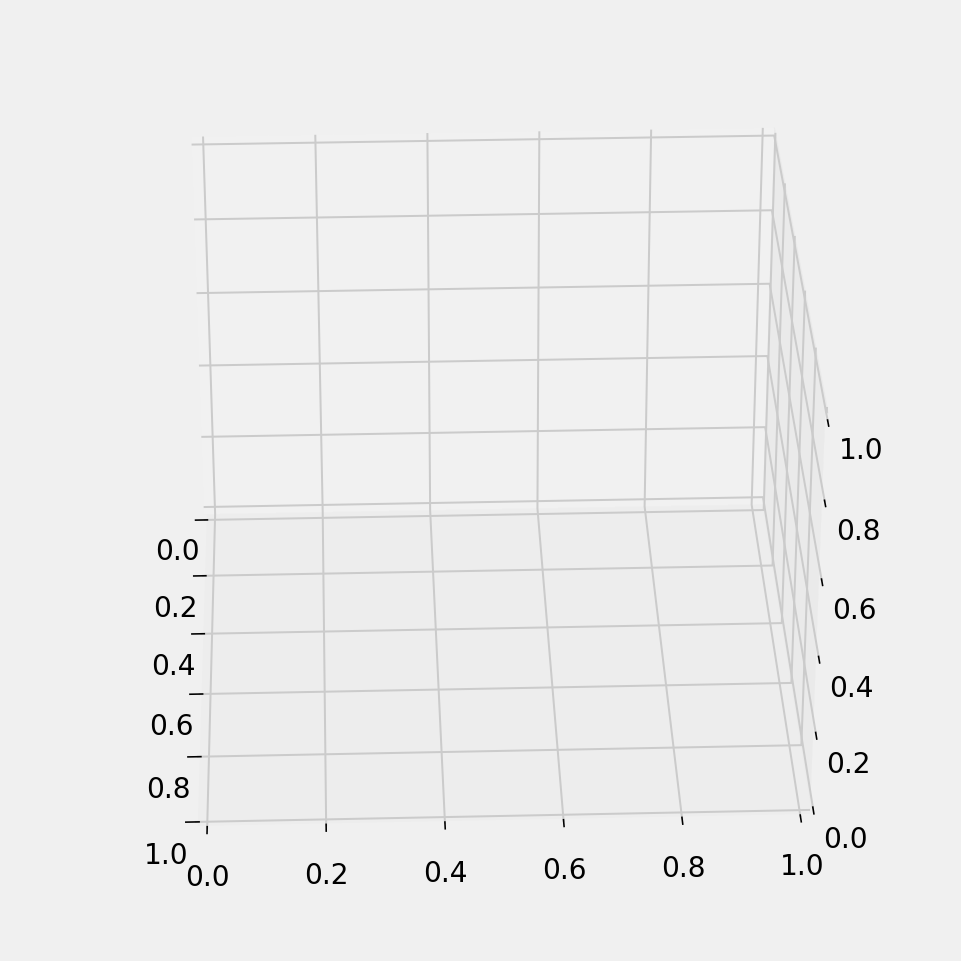

In [46]:
# Let's do better and create a animated gif.
# Create a 3D scatter plot
fig = plt.figure(figsize=(8, 8), dpi=144)
ax = fig.add_subplot(111, projection='3d')

# Define the number of frames for the rotation
num_frames = 144

# Create a list to store frames
frames = []

# Generate frames for rotation
for angle in range(0, 360, 360 // num_frames):
    ax.view_init(elev=30, azim=angle)
    
    # Clear the previous scatter plot
    ax.clear()
    
    # Create a new scatter plot for each frame
    sc = ax.scatter(transformed_precip[:, 0],
                    transformed_precip[:, 1],
                    transformed_precip[:, 2],
                    c=kmeans_precip.labels_)
    
    ax.set_xlabel('PC1')
    ax.set_ylabel('PC2')
    ax.set_zlabel('PC3')
    
    buf = io.BytesIO()
    plt.savefig(buf, format='png')
    buf.seek(0)
    frames.append(imageio.imread(buf))
    buf.close()
    ax.clear()

# Save frames as a GIF
imageio.mimsave('../../../images/scatter_plot_rotation.gif', frames, fps=10)

Let's view the STATION_PRESSURE clusters in 3D.

In [29]:
fig = px.scatter_3d(x=transformed_pressure[:, 0],
                    y=transformed_pressure[:, 1],
                    z=transformed_pressure[:, 2],
                    color=[str(l) for l in kmeans_pressure.labels_],
                    opacity=0.5)
fig.show('notebook')

There is poor performance for K-means clustering for pressure. Let's use and visualize a Gaussian mixture model instead.

In [30]:
gmm = GaussianMixture(n_components=3, random_state=0)
gmm.fit(transformed_pressure)
pressure_labels = gmm.predict(transformed_pressure)

fig = px.scatter_3d(x=transformed_pressure[:, 0],
                    y=transformed_pressure[:, 1],
                    z=transformed_pressure[:, 2],
                    color=[str(l) for l in pressure_labels])
fig.show('notebook')

Much better!

Let's see if the precipitation clusters have any meaning in terms of the radar images. Let's load the radar images as a memory-mapped array, as to save memory.

In [84]:
# Load radar image dates
weather_images = pd.read_csv('../radar/processed/image_dates.csv', parse_dates=['UTC_DATE']).reset_index(drop=True)
weather_images['IMAGE_INDEX'] = range(len(weather_images))
station_dates = pd.read_csv('../weather/processed/BARRIE-ORO.csv', parse_dates=['UTC_DATE'])[['UTC_DATE']]
station_dates['STATION_INDEX'] = range(len(station_dates))
weather_images = station_dates.merge(weather_images, on='UTC_DATE', how='inner')

# Load radar images
radar_images = np.load('../radar/processed/all_images.npy', mmap_mode='r')[weather_images['IMAGE_INDEX']]

# Only get labels at hours where there is a radar image
labels = kmeans_precip.labels_[weather_images['STATION_INDEX']]

mean_images = []

for i in range(4):
    print('Checking for cluster', i)
    radar_subset = radar_images[labels == i]
    mean_images.append(np.mean(radar_subset, axis=0))
    del radar_subset

Checking for cluster 0
Checking for cluster 1
Checking for cluster 2
Checking for cluster 3


And let's plot our results.

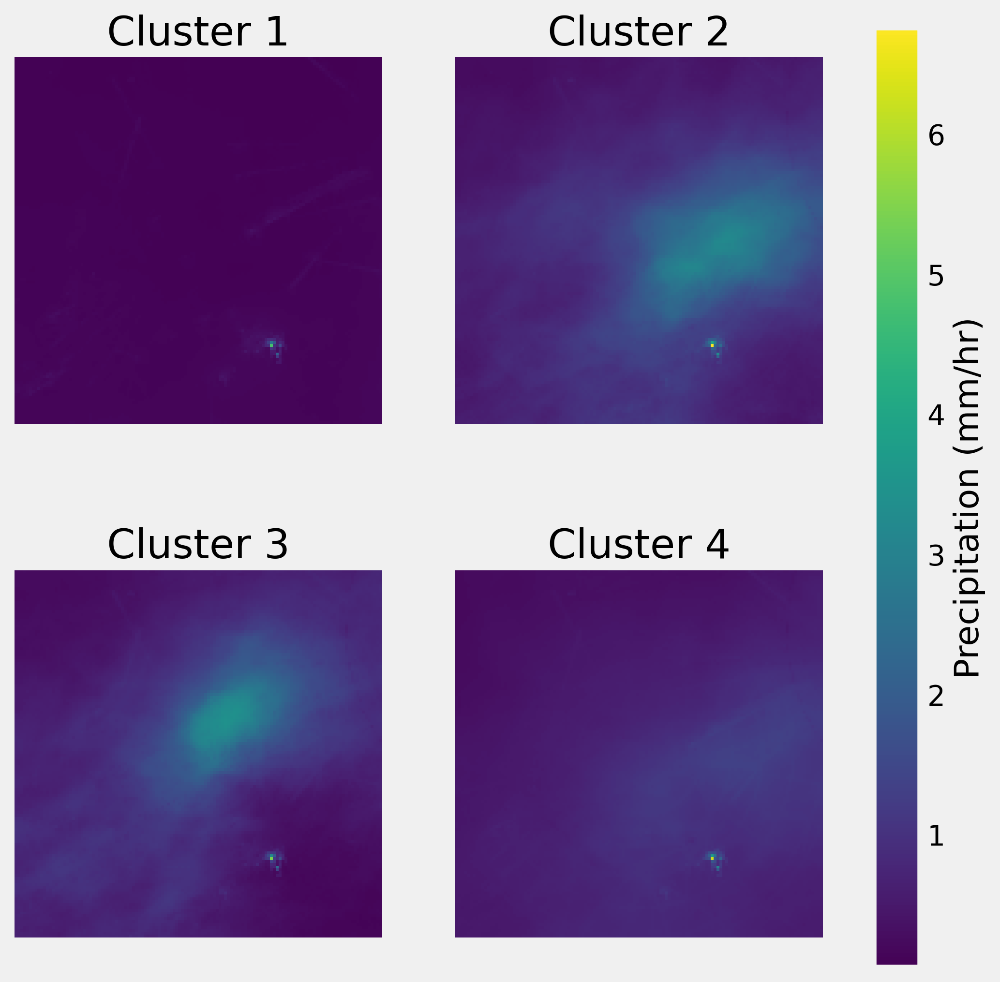

In [85]:
# Radar images
img1 = mean_images[0]
img2 = mean_images[1]
img3 = mean_images[2]
img4 = mean_images[3]

# Calculate min and max values among all images
min_val = min(img1.min(), img2.min(), img3.min(), img4.min())
max_val = max(img1.max(), img2.max(), img3.max(), img4.max())

fig, axs = plt.subplots(2, 2, figsize=(8, 8), dpi=300)  # Creating a 2x2 subplot grid

# Display each image on its respective subplot with the same color scaling
im = axs[0, 0].imshow(img1, vmin=min_val, vmax=max_val)
axs[0, 1].imshow(img2, vmin=min_val, vmax=max_val)
axs[1, 0].imshow(img3, vmin=min_val, vmax=max_val)
axs[1, 1].imshow(img4, vmin=min_val, vmax=max_val)

# Hide the axis labels and ticks for better visualization (optional)
for i, ax in enumerate(axs.flatten()):
    ax.axis('off')
    ax.set_title(f'Cluster {i + 1}')

plt.colorbar(im, label='Precipitation (mm/hr)', ax=axs)
plt.savefig('../../../images/precip_clusters_radar.png')

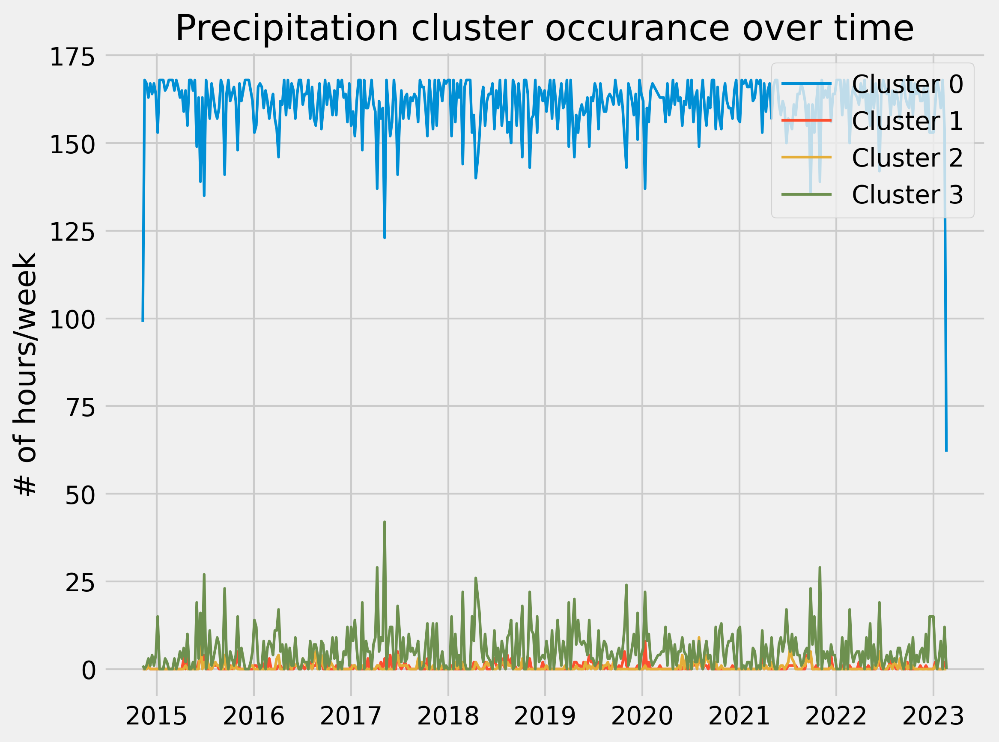

In [88]:
# Show occurrence of these features over temporal dimension now.
temp_df = pd.DataFrame(data={'dates': station_dates['UTC_DATE'], 'labels': kmeans_precip.labels_})
temp_df = temp_df.set_index('dates')
temp_df = temp_df.groupby(pd.Grouper(freq='W'))['labels'].value_counts().unstack(fill_value=0)

plt.figure(figsize=(8, 6), dpi=300)

# Plotting each cluster
for i in range(4):
    plt.plot(temp_df.index, temp_df[i], label=f'Cluster {i}', lw=1.5)

# Plot labels
plt.title('Precipitation cluster occurance over time')
plt.ylabel('# of hours/week')
plt.legend(loc=1)
plt.tight_layout()
plt.savefig('../../../images/precip_clusters_time.png')

Not much meaning temporally! Now, let's explore the temporal distribution of the STATION_PRESSURE clusters we found earlier...

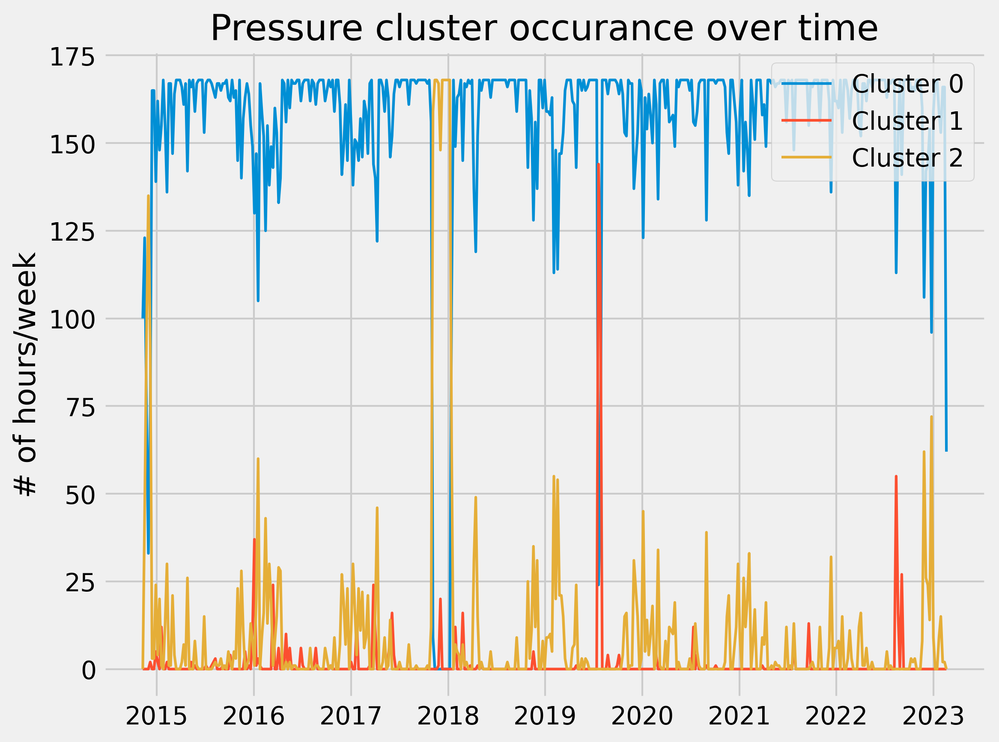

In [89]:
# Show occurrence of these features over temporal dimension now.
temp_df = pd.DataFrame(data={'dates': station_dates['UTC_DATE'], 'labels': pressure_labels})
temp_df = temp_df.set_index('dates')
temp_df = temp_df.groupby(pd.Grouper(freq='W'))['labels'].value_counts().unstack(fill_value=0)

plt.figure(figsize=(8, 6), dpi=300)

# Plotting each cluster
for i in range(3):
    plt.plot(temp_df.index, temp_df[i], label=f'Cluster {i}', lw=1.5)

# Plot labels
plt.title('Pressure cluster occurance over time')
plt.ylabel('# of hours/week')
plt.legend(loc=1)
plt.tight_layout()
plt.savefig('../../../images/pressure_clusters_time.png')

That's very strange. Let's also look at the average pressure across stations.

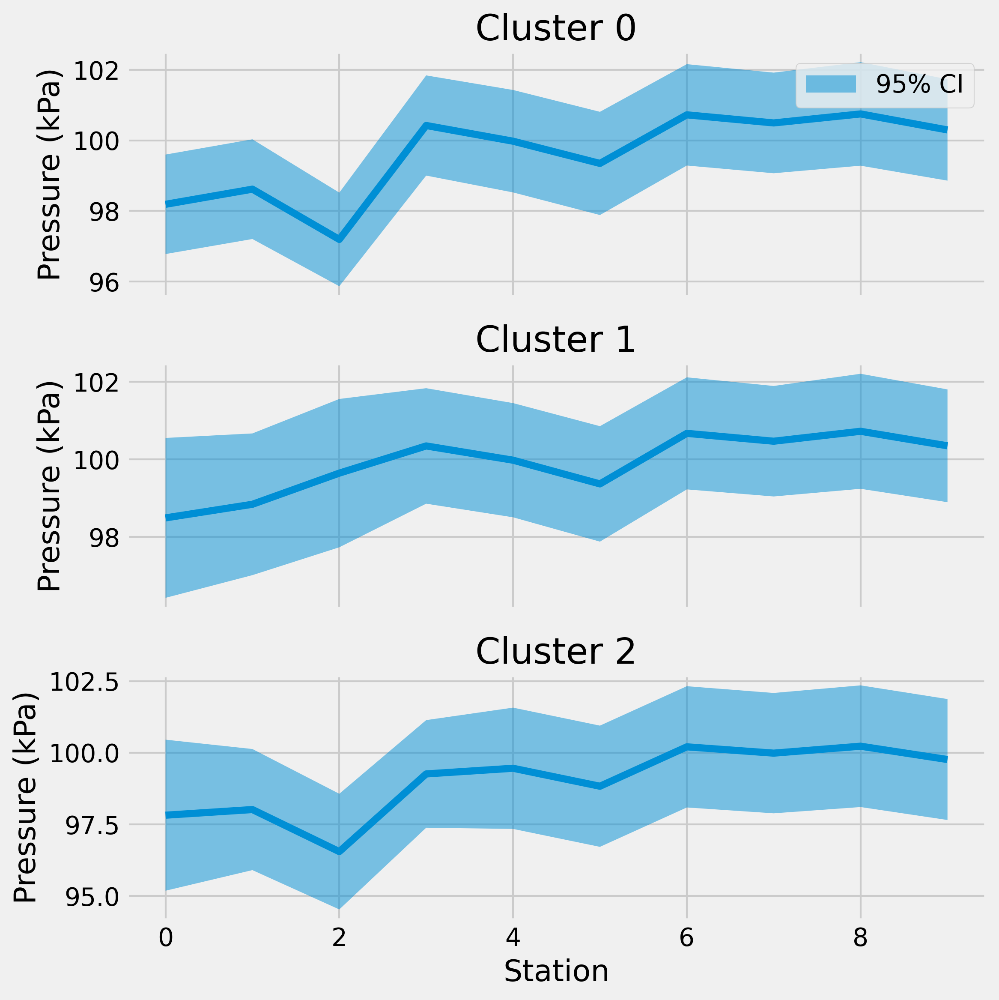

In [90]:
fig, axs = plt.subplots(3, 1, figsize=(8, 8), sharex=True, dpi=300)  # Creating a 2x2 subplot grid

# Plot each distribution of pressure for each cluster
for i, ax in enumerate(axs.flatten()):
    pressure_i = pressure[pressure_labels == i]
    
    mean = np.mean(pressure_i, axis=0)
    std = np.std(pressure_i, axis=0)
    
    ax.plot(range(10), mean)
    ax.fill_between(range(10), mean - 1.95 * std, mean + 1.95 * std, alpha=0.5, label='95% CI')
    ax.set_title(f'Cluster {i}')
    ax.set_ylabel('Pressure (kPa)')

# Only one x-axis label is needed
ax.set_xlabel('Station')
axs[0].legend(loc=1)
plt.tight_layout()

This shows that the spatial distribution of the clusters is basically the same. Perhaps STATION_PRESSURE is too correlated to exhibit any meaningful clusters, after all. Let's investigate the correlation between the precipitation from the weather stations and from the weather radar. As the weather radar is quite coarse in resolution, let's compare maximum precipitation.

In [104]:
# Find maximum rain for any station
rain = []
for weather_station in weather_stations:
    rain.append(weather_station.iloc[weather_images['STATION_INDEX']]['PRECIP_AMOUNT'].to_numpy())

rain = np.column_stack(np.array(rain))
print(rain.shape)
rain = np.max(rain, axis=1)

# Find maximum rain for radar images
# Note: need to apply step to ignore area of image
# when computing maximum. It seems that there is
# an artifact that needs to be accounted for.
multiplier = (mean_images[0] <= 0.3).astype(int)
rain_radar = []

for i, image in enumerate(radar_images):
    rain_radar.append(np.max(image * multiplier))

rain_radar = np.array(rain_radar)

(71238, 10)


Let's get the correlation coefficient first.

In [105]:
corr = np.corrcoef(rain, rain_radar)[0, 1]
print(f'Correlation coefficient: {corr}')

Correlation coefficient: 0.29270797807047266


This correlation coefficient is quite low--showing that the radar data isn't closely correlated with the precipitation data. This could mean two things: (1) the radar data is introducing more information or (2) the radar data is showing error which makes it differ from weather station precipitation data.

Let's plot the trend.

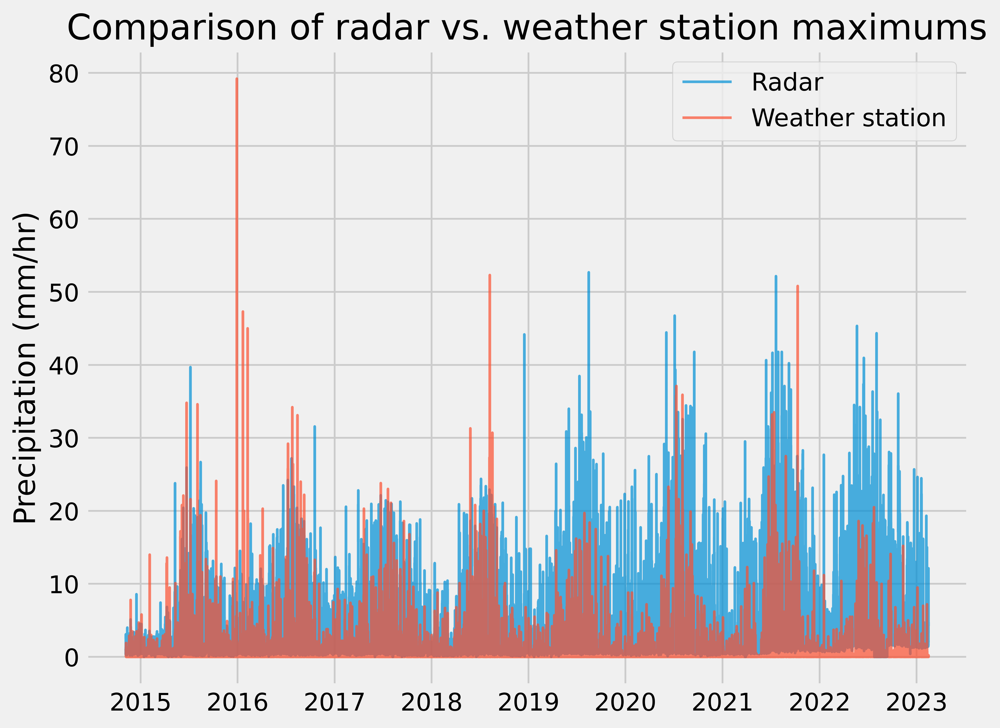

In [110]:
plt.figure(figsize=(8, 6), dpi=600)

# Plot precipitation for radar and weather station
plt.plot(weather_images['UTC_DATE'], rain_radar, alpha=0.7, lw=1.5, label='Radar')
plt.plot(weather_images['UTC_DATE'], rain, alpha=0.7, lw=1.5, label='Weather station')

# Plot labels
plt.title('Comparison of radar vs. weather station maximums')
plt.ylabel('Precipitation (mm/hr)')
plt.legend()
plt.tight_layout()
plt.savefig('../../../images/precip_compare.png')

Radar data usually always shows a higher maximum than weather station data. This makes sense, as the weather radar covers a larger geographical area, and is thus more likely to pick up on a higher value. This also indicates the weather radar data is useful: it provides new information in addition to weather station data.